In [2]:
import os
import numpy as np
from skimage import io, img_as_float
from skimage.metrics import mean_squared_error, structural_similarity
import matplotlib.pyplot as plt
import json

def load_images_from_directory(directory):
    images = []
    filenames = []
    for filename in os.listdir(directory):
        if filename.endswith(('.png')):
            filepath = os.path.join(directory, filename)
            images.append(img_as_float(io.imread(filepath)))
            filenames.append(filename)
    return images, filenames

def calculate_mse_matrix(images):
    num_images = len(images)
    mse_matrix = np.zeros((num_images, num_images))
    for i in range(num_images):
        for j in range(i+1, num_images):
            mse_matrix[i, j] = mean_squared_error(images[i], images[j])
    return mse_matrix

def calculate_ssim_matrix(images):
    num_images = len(images)
    ssim_matrix = np.zeros((num_images, num_images))
    for i in range(num_images):
        for j in range(i+1, num_images):
            min_dim = min(images[i].shape[:2])
            win_size = min(7, min_dim // 2 * 2 + 1)  # Ensure win_size is odd and <= min_dim
            ssim_matrix[i, j] = structural_similarity(images[i], images[j], multichannel=True, win_size=win_size)
    return ssim_matrix

def plot_matrix(matrix, title, filenames):
    fig, ax = plt.subplots()
    cax = ax.matshow(matrix, cmap='viridis')
    fig.colorbar(cax)
    # ax.set_xticks(np.arange(len(filenames)))
    # ax.set_yticks(np.arange(len(filenames)))
    # ax.set_xticklabels(filenames, rotation=90)
    # ax.set_yticklabels(filenames)
    plt.title(title)
    plt.show()

def save_matrices_and_paths(mse_matrix, filenames, output_dir, ssim_matrix=None):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        
    np.save(os.path.join(output_dir, 'mse_matrix.npy'), mse_matrix)
    #np.save(os.path.join(output_dir, 'ssim_matrix.npy'), ssim_matrix)
    
    with open(os.path.join(output_dir, 'filenames.json'), 'w') as f:
        json.dump(filenames, f)

def main():
    directory = '/home/bule/projects/datasets/mvtec_anomaly_detection/toothbrush/train/good'
    output_dir = '/home/bule/projects/UTRAD/results/beantec/allresults'
    
    images, filenames = load_images_from_directory(directory)
    
    mse_matrix = calculate_mse_matrix(images)
    plot_matrix(mse_matrix, 'MSE Matrix', filenames)
    
    
    # ssim_matrix = calculate_ssim_matrix(images)


    # plot_matrix(ssim_matrix, 'SSIM Matrix', filenames)
    
    #save_matrices_and_paths(mse_matrix,filenames, output_dir)
#main()

In [3]:
import json

# Load filenames from JSON file
with open('/home/bule/projects/UTRAD/results/beantec/allresults/filenames.json', 'r') as f:
    filenames = json.load(f)

# Print the loaded filenames
print(filenames)

['0412.png', '0813.png', '0805.png', '0171.png', '0692.png', '0933.png', '0433.png', '0902.png', '0266.png', '0339.png', '0125.png', '0531.png', '0803.png', '0126.png', '0508.png', '0552.png', '0140.png', '0643.png', '0197.png', '0675.png', '0658.png', '0023.png', '0997.png', '0391.png', '0103.png', '0452.png', '0203.png', '0176.png', '0823.png', '0527.png', '0478.png', '0174.png', '0109.png', '0696.png', '0517.png', '0362.png', '0399.png', '0413.png', '0172.png', '0463.png', '0511.png', '0230.png', '0537.png', '0545.png', '0341.png', '0889.png', '0781.png', '0405.png', '0507.png', '0394.png', '0388.png', '0241.png', '0270.png', '0389.png', '0772.png', '0827.png', '0421.png', '0459.png', '0655.png', '0462.png', '0009.png', '0498.png', '0312.png', '0284.png', '0005.png', '0911.png', '0991.png', '0387.png', '0357.png', '0401.png', '0597.png', '0444.png', '0040.png', '0596.png', '0162.png', '0839.png', '0931.png', '0680.png', '0078.png', '0993.png', '0004.png', '0146.png', '0974.png', '05

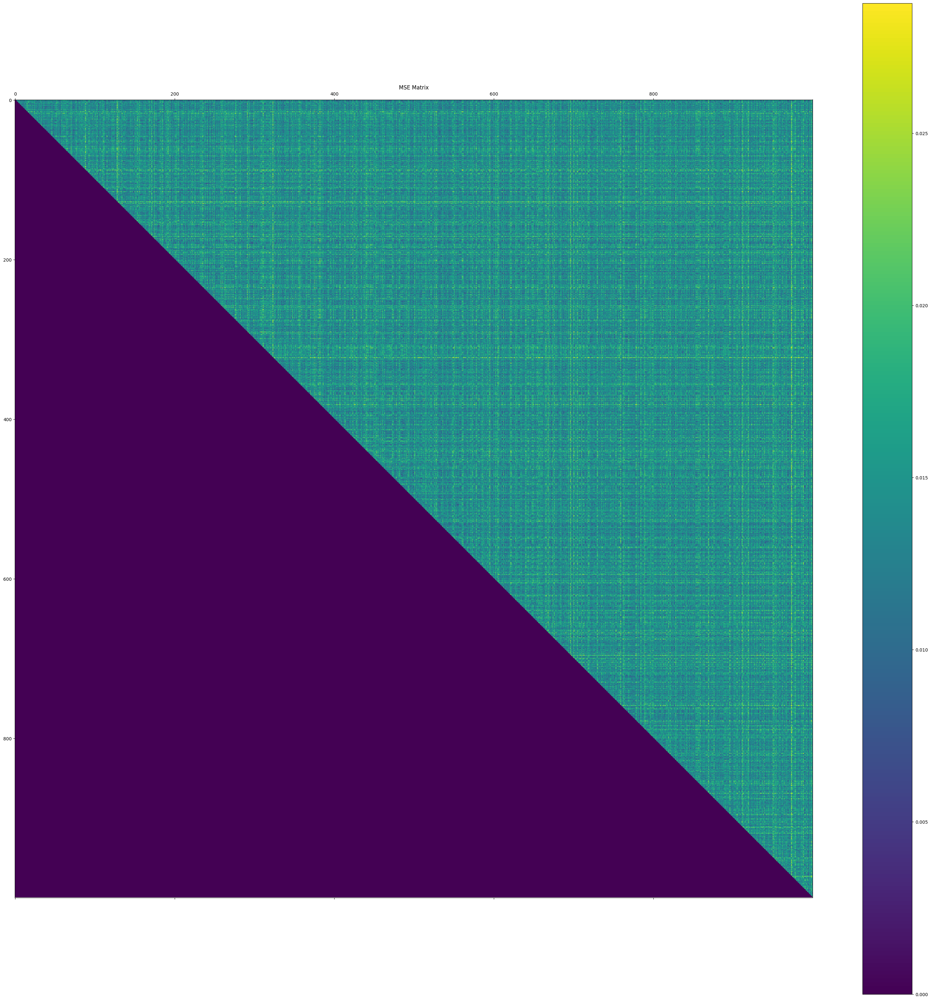

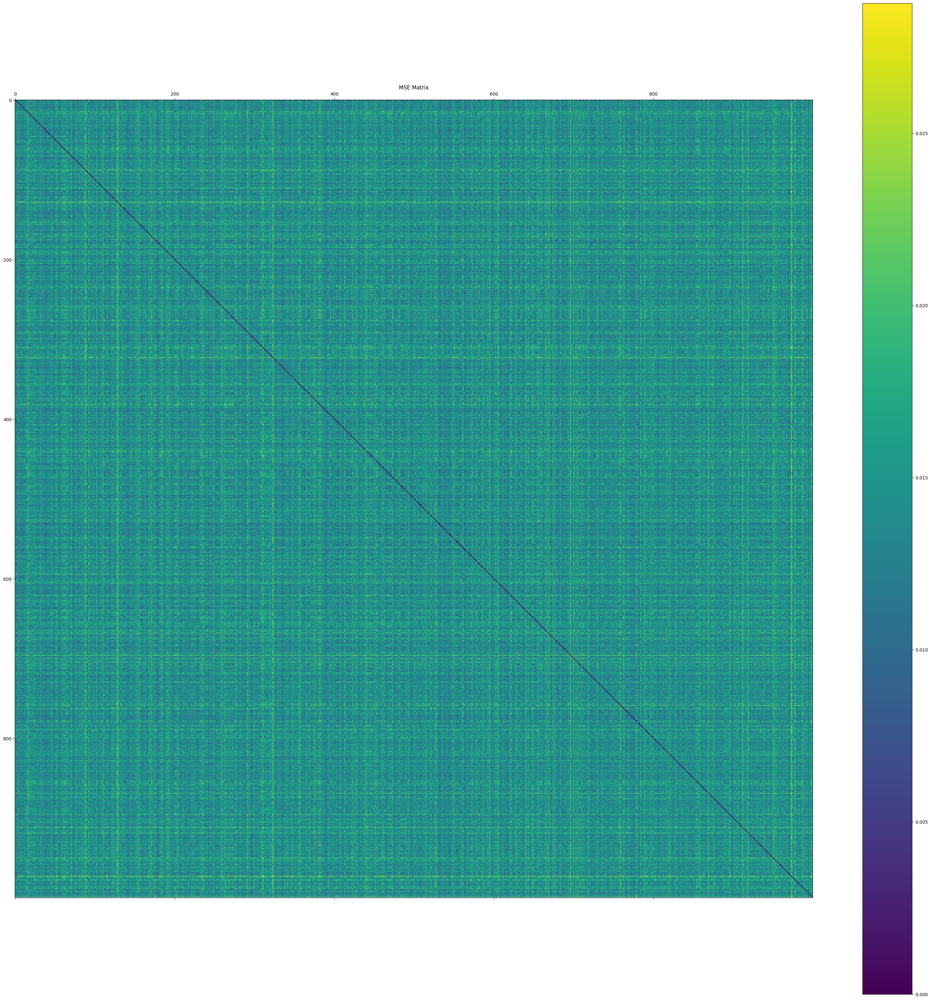

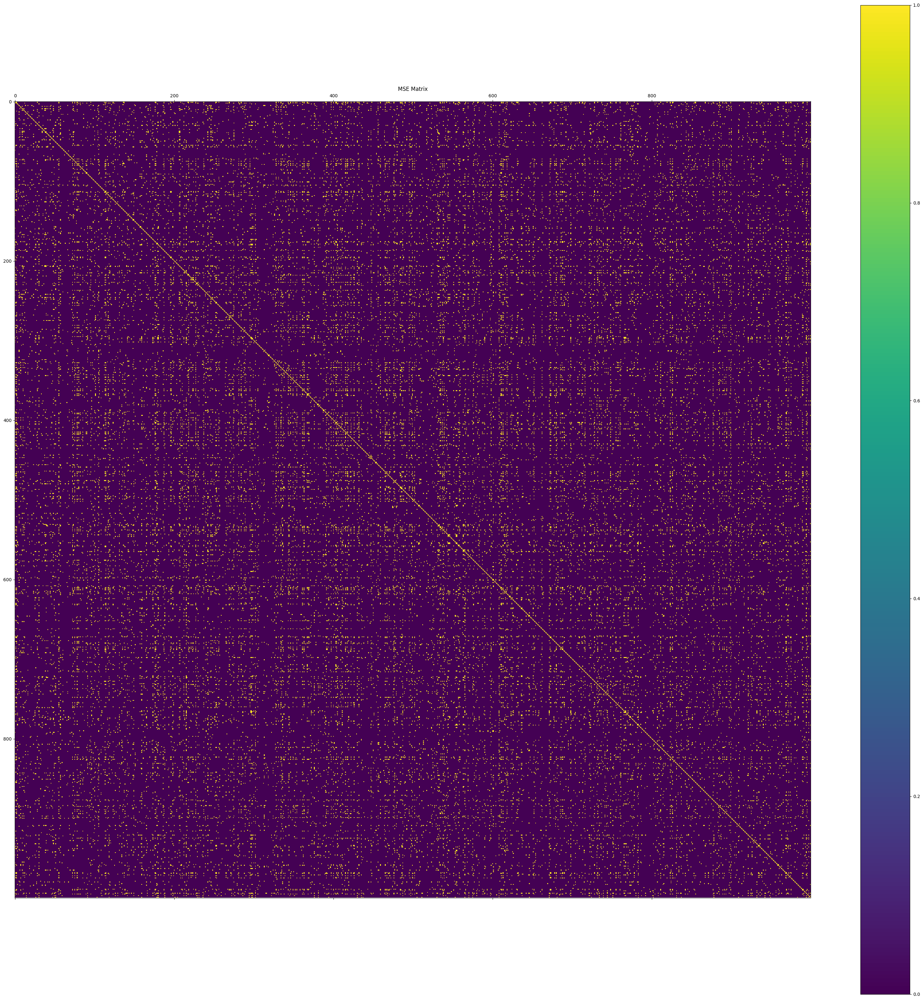

In [4]:
import numpy as np
def plot_matrix(matrix, title, filenames):
    
    fig, ax = plt.subplots(figsize=(40, 40))
    
    cax = ax.matshow(matrix, cmap='viridis')
    fig.colorbar(cax)
    # ax.set_xticks(np.arange(len(filenames)))
    # ax.set_yticks(np.arange(len(filenames)))
    # ax.set_xticklabels(filenames, rotation=90)
    # ax.set_yticklabels(filenames)
    plt.title(title)
    plt.show()




mse_matrix = np.load('/home/bule/projects/UTRAD/results/beantec/allresults/mse_matrix.npy')

plot_matrix(mse_matrix, 'MSE Matrix', filenames)


symmetric_matrix = mse_matrix + mse_matrix.T - np.diag(mse_matrix.diagonal())
plot_matrix(symmetric_matrix, 'MSE Matrix', filenames)


result = np.where(symmetric_matrix < 0.01, 1, 0)
plot_matrix(result, 'MSE Matrix', filenames)




In [35]:
import numpy as np
from sklearn.cluster import AgglomerativeClustering


distance_matrix=symmetric_matrix
threshold = 0.01


# Using Agglomerative Clustering for example
clustering = AgglomerativeClustering(
    n_clusters=None, 
    distance_threshold=threshold, 
    metric='precomputed', 
    linkage='average'
)
labels = clustering.fit_predict(distance_matrix)
print(len(np.unique(labels)))

def select_representative_images(labels, distance_matrix):
    unique_labels = np.unique(labels)
    print(unique_labels)
    representative_images = []

    for label in unique_labels:
        cluster_indices = np.where(labels == label)[0]
        avg_distances = np.mean(distance_matrix[np.ix_(cluster_indices, cluster_indices)], axis=1)
        representative_image_index = cluster_indices[np.argmin(avg_distances)]
        representative_images.append(representative_image_index)

    return representative_images

representative_images = select_representative_images(labels, distance_matrix)

# Now representative_images contains the indices of the selected representative images
# Display images in a rectangular plot
def display_images(images, rows, cols):
    fig, axes = plt.subplots(rows, cols, figsize=(15, 10))
    axes = axes.flatten()

    for img, ax in zip(images, axes):
        ax.imshow(img)
        ax.axis('off')

    plt.tight_layout()
    plt.show()
# Example usage:
print("Selected representative images:", representative_images)


292
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233
 234 235 236 237 238 239 240 241 242 243 244 24

/tmp/ipykernel_3922001/2220136071.py:2: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method='average')


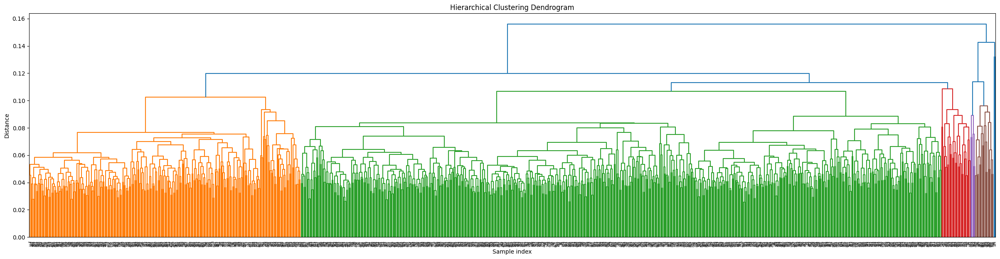

Selected representative images: [285, 484, 897, 155, 708, 581, 329, 40, 376, 241, 319, 958, 73, 365, 736, 956, 608, 163, 518, 701, 855, 741, 172, 979, 250, 707, 185, 166, 388, 220, 598, 105, 150, 909, 456, 356, 945, 58, 621, 866, 119, 339, 389, 527, 160, 72, 679, 816, 820, 252, 693, 164, 227, 717, 603, 813, 287, 516, 731, 393, 525, 94, 776, 290, 347, 397, 74, 829, 68, 479, 96, 129, 409, 168, 847, 493, 595, 524, 545, 395, 888, 446, 107, 401, 510, 321, 841, 154, 120, 986, 501, 165, 293, 330, 982, 933, 734, 753, 229, 600, 434, 976, 561, 633, 53, 292, 902, 605, 901, 915, 390, 300, 850, 427, 408, 916, 359, 876, 899, 470, 342, 144, 973, 22, 247, 32, 343, 466, 236, 905, 647, 858, 46, 124, 908, 207, 50, 34, 824, 583, 180, 362, 87, 629, 110, 455, 531, 852, 17, 414, 81, 325, 226, 370, 416, 202, 689, 506, 796, 249, 666, 262, 283, 233, 978, 301, 93, 423, 912, 705, 801, 169, 266, 386, 128, 89, 947, 800, 607, 684, 258, 31, 203, 696, 461, 650, 382, 528, 189, 903, 919, 627, 789, 373, 606, 998, 445, 33

In [29]:
from scipy.cluster.hierarchy import dendrogram, linkage
linkage_matrix = linkage(distance_matrix, method='average')

# Plot the dendrogram
plt.figure(figsize=(30, 7))
dendrogram(linkage_matrix)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample index')
plt.ylabel('Distance')
plt.show()

# Example usage:
print("Selected representative images:", representative_images)


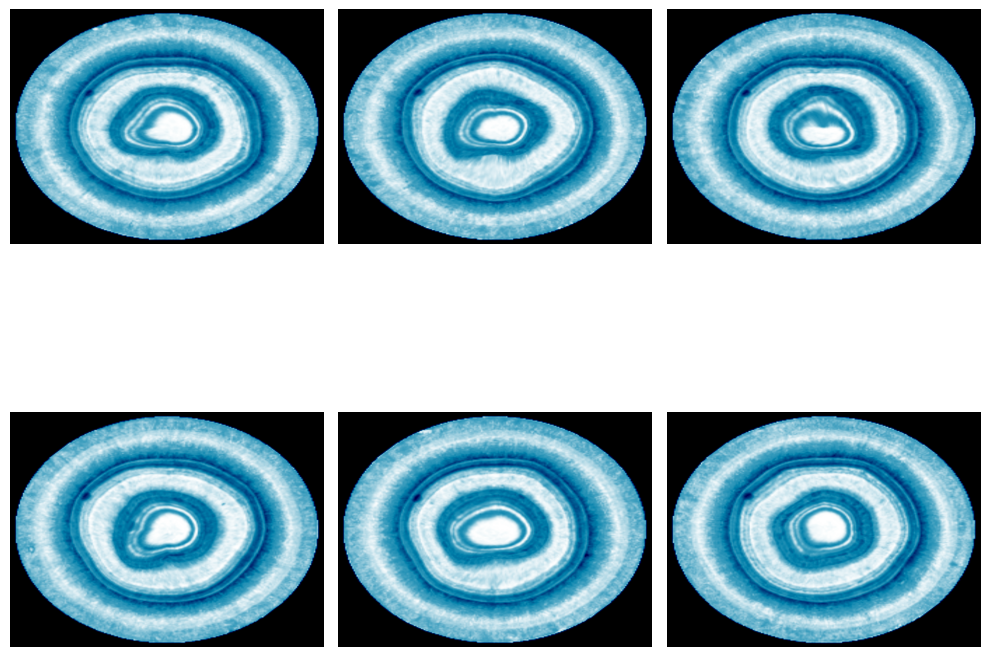

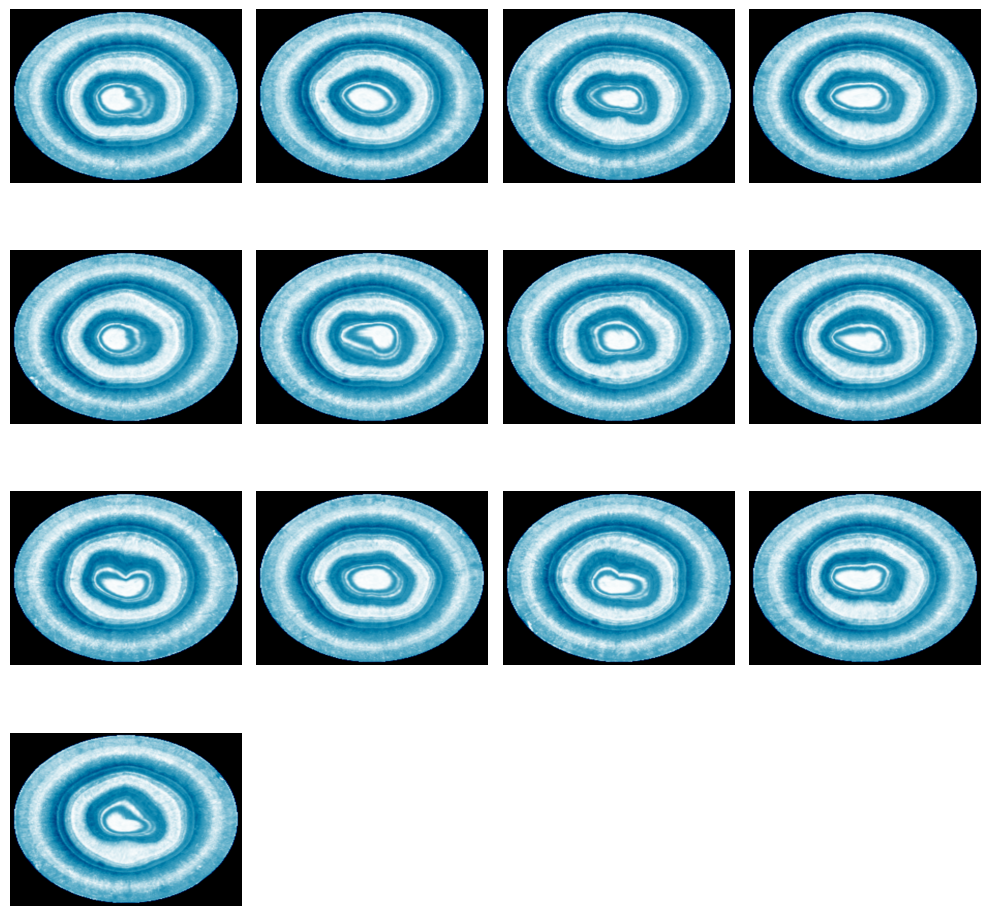

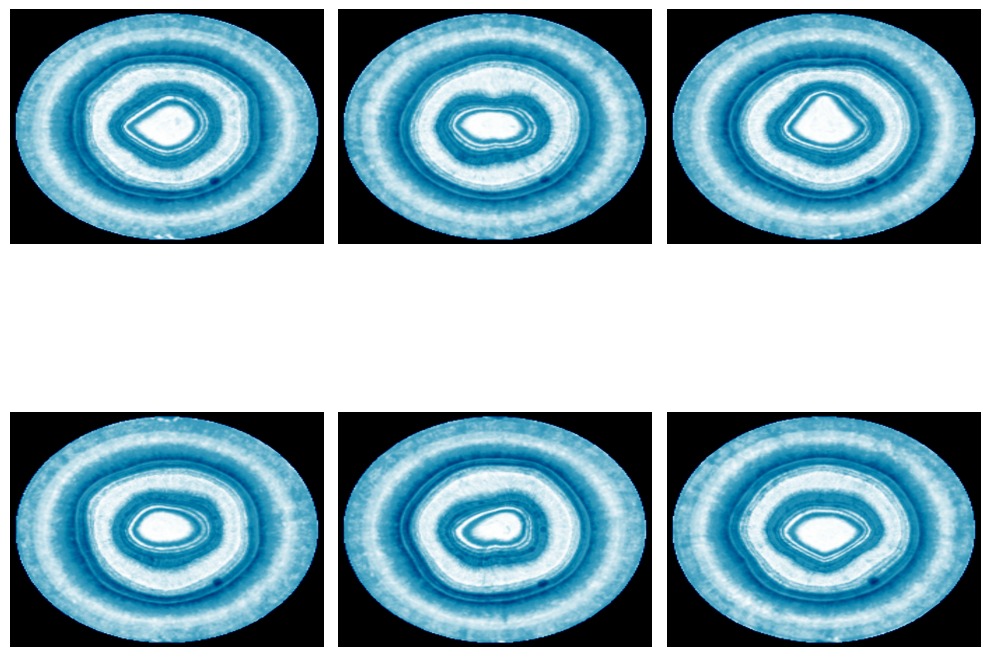

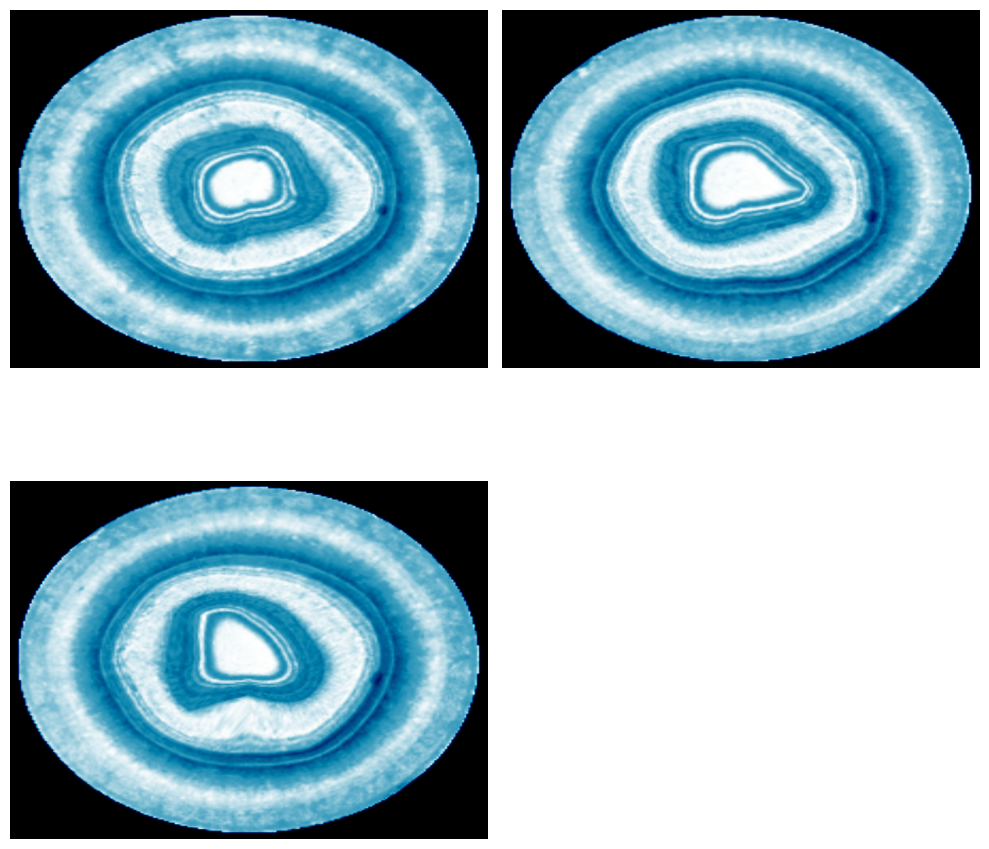

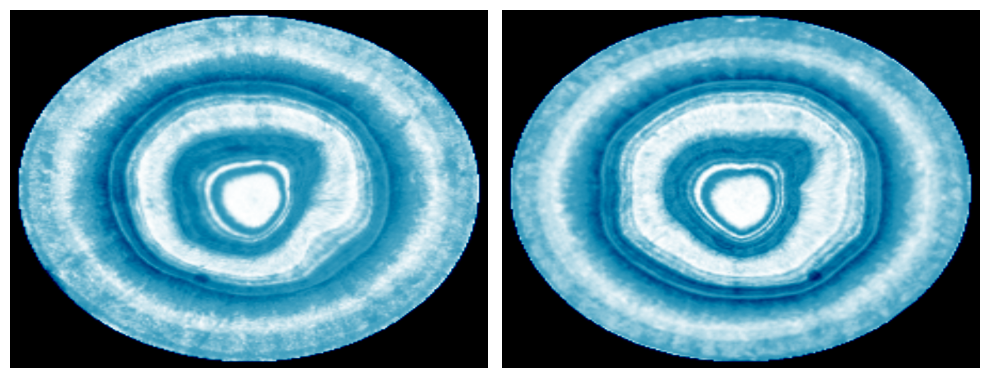

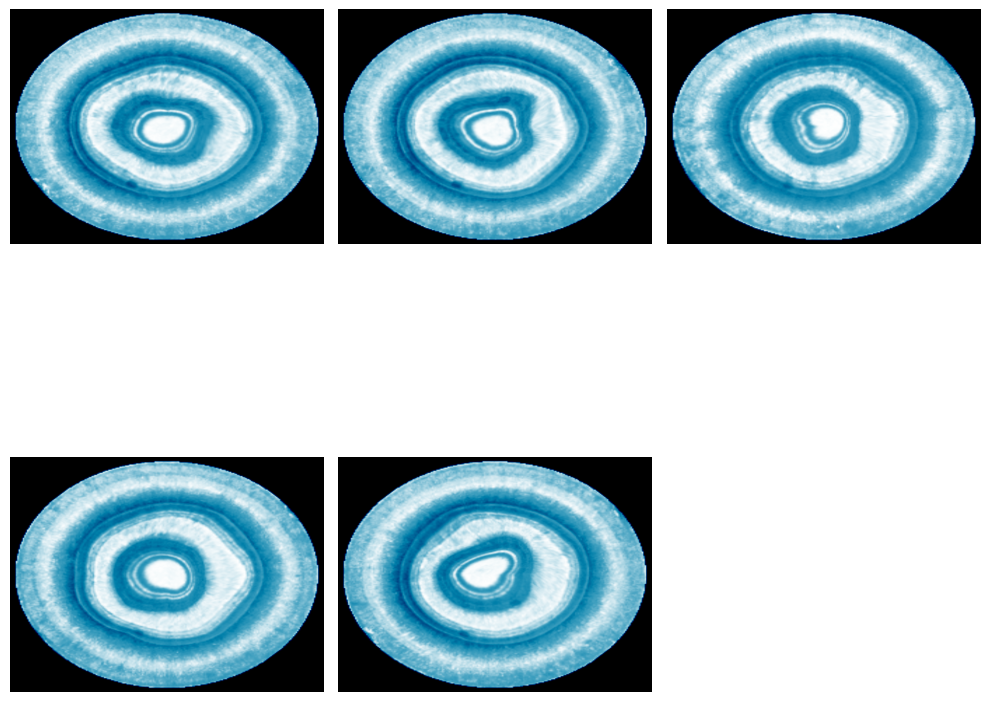

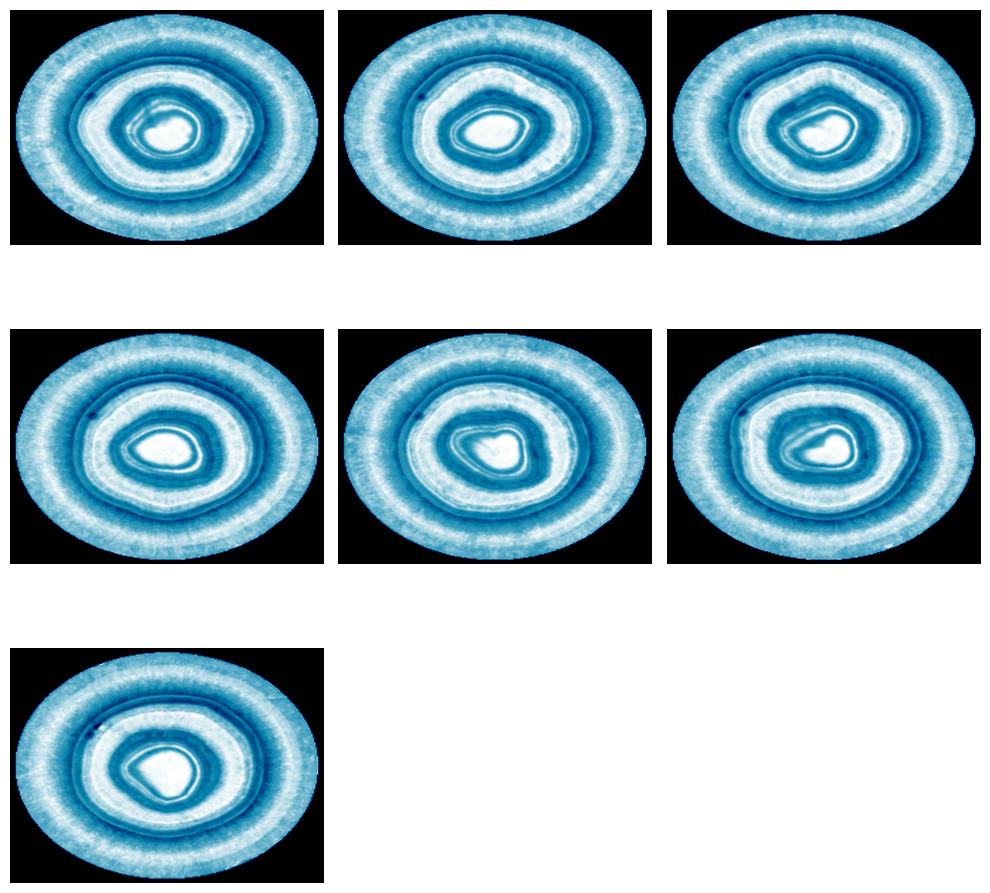

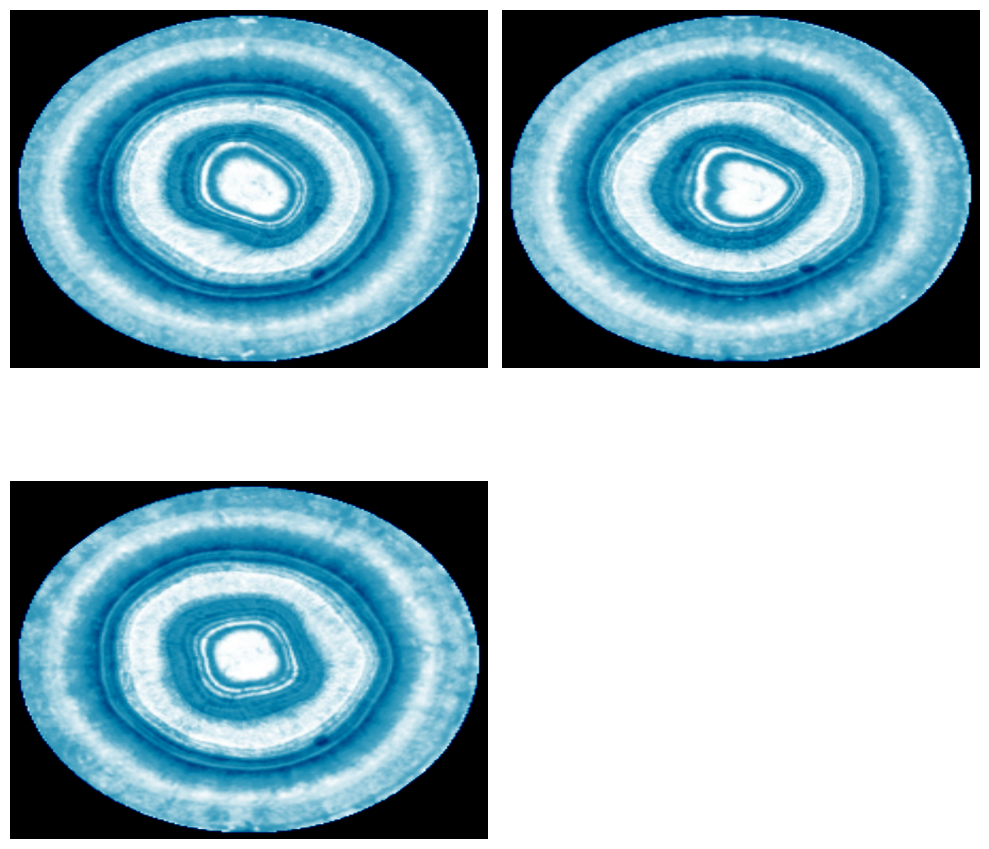

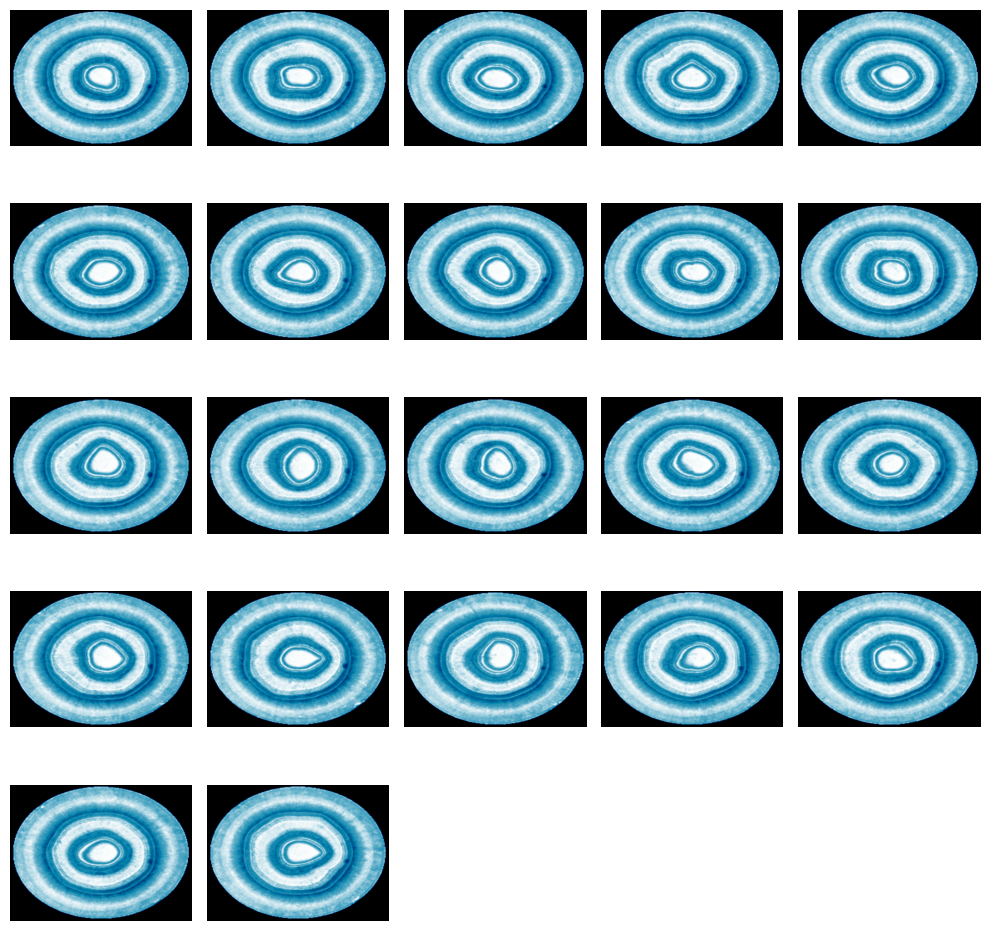

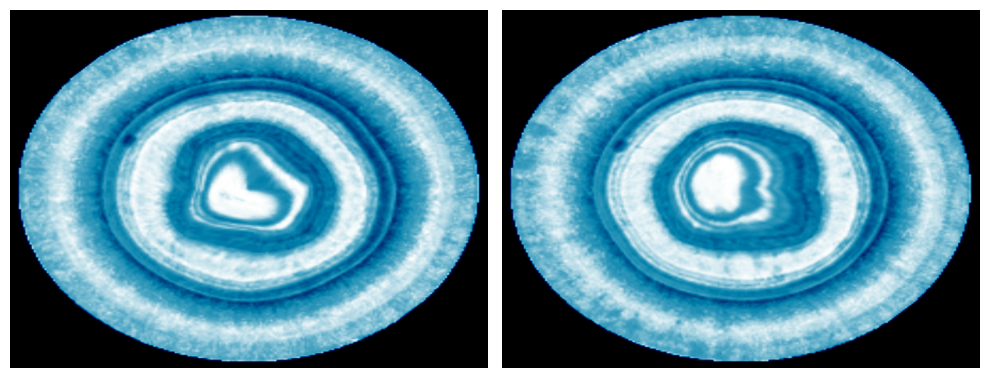

In [15]:
from PIL import Image
from math import ceil, sqrt

path='/home/bule/projects/datasets/BTech_Dataset_transformed/03/train/ok'

label=2
for label in range(10):
    image_filenames=[filenames[i] for i in np.where(labels == label)[0]]

    # Load images
    images = [Image.open(os.path.join(path, filename)) for filename in image_filenames]

    # Calculate the number of rows and columns for a square layout
    num_images = len(images)
    cols = int(ceil(sqrt(num_images)))
    rows = int(ceil(num_images / cols))

    # Display images in a rectangular plot
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(10, 10))

    for i, ax in enumerate(axes.flatten()):
        if i < num_images:
            ax.imshow(images[i], cmap='viridis')
            ax.axis('off')
        else:
            fig.delaxes(ax)  # Remove unused axes

    plt.tight_layout()
    plt.show()


In [33]:
print(len(image_filenames))

292


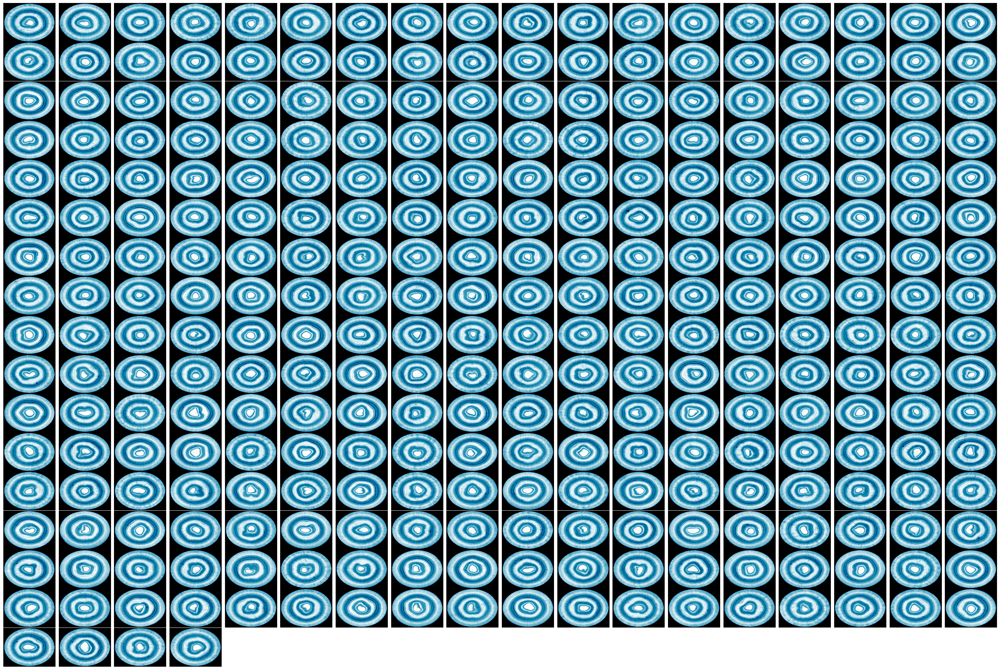

In [24]:
image_filenames=[filenames[i] for i in representative_images]

# Load images
images = [Image.open(os.path.join(path, filename)) for filename in image_filenames]

# Calculate the number of rows and columns for a square layout
num_images = len(images)
cols = int(ceil(sqrt(num_images)))
rows = int(ceil(num_images / cols))

# Display images in a rectangular plot
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(30, 20))

for i, ax in enumerate(axes.flatten()):
    if i < num_images:
        ax.imshow(images[i], cmap='viridis')
        ax.axis('off')
    else:
        fig.delaxes(ax)  # Remove unused axes

plt.subplots_adjust(wspace=0.0001, hspace=0.1)
plt.tight_layout(pad=0.01)
plt.show()





In [38]:
import json

# Define the filename for the JSON file
json_filename = 'image_filenames.json'


image_filenames2=[os.path.join(path, filename) for filename in image_filenames]


# Save the image filenames as JSON
with open(json_filename, 'w') as f:
    json.dump(image_filenames2, f)

# Print a message to confirm the saving of the JSON file
print(f"The image filenames have been saved as {json_filename}.")

The image filenames have been saved as image_filenames.json.
